# Advanced Lane Detection

### Introduction  

Building on the previous project we can use more advanced image processing techniques to detect lane lines under a wider variety of conditions. Using camera calibration, thresholds on edge detection, color space thresholds, perspective transforms, and searching techniques we can get a much better fit for our lane detection pipeline. I am using a lot of helper methods below to cut down on the amount of code in the notebook while still allowing functions to be configurable. This project can be ran through the notebook or through the command line by executing the main.py script with python.

## Pipeline

#### Setup
1. Calibrate camera

#### Image Processing
1. Undistort image
2. Edge detection  
  a. Gradient threshold  
  b. Magnitude threshold  
  c. Direction threshold
3. S channel threshold
4. Perspective transform  
5. Find lane lines  
  a. Finding pixels with sliding windows  
  b. Fit polynomial  
  c. Search around polynomial  
  d. Fill lane  
  e. Measure curvature  
  d. Measure offset
6. Unwarp image  
7. Draw UI   


In [1]:
from camera import Camera
from edgedetection import EdgeDetection
from plot import plot_images, plot_image
from image import load_images, load_image
from lanes import Lane
from pipeline import detect_edges, transform_perspective, find_lane_lines
import matplotlib.pyplot as plt
import os
import glob
import numpy as np
import cv2
from moviepy.editor import VideoFileClip
from IPython.display import HTML
%matplotlib inline


In [2]:
# Root of Project
file_root = os.path.dirname(os.path.abspath(os.path.abspath('')))

## Camera Calibration  

The first stage of the lane detection pipeline is camera calibration. Camera calibration is necessary because all cameras have some type of distortion due to their lenses. The basic idea behind camera calibration is to take pictures of a chessboard pattern from different viewing angles and distances. A chessboard pattern is used because there is a lot of contrast make it easy to detect corners. Based on the corners detected in each image distortion coefficients can be calculated which can be used to remove distortion from images created using that camera. Plotted below are the calibration images with their detected corners drawn on them.

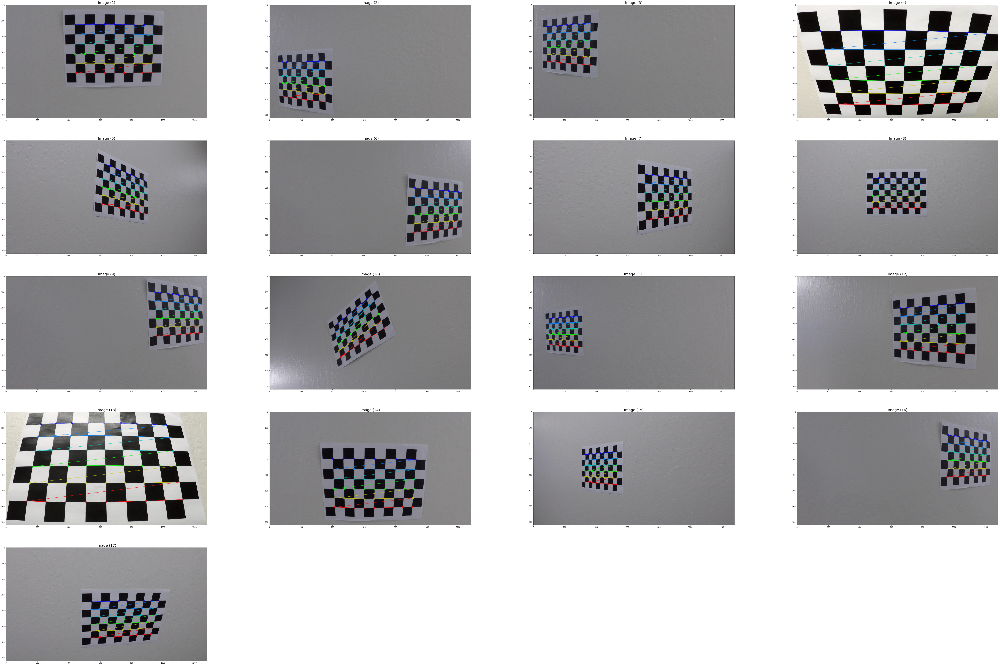

In [3]:
# Load images
calibration_images = load_images(glob.glob(os.path.join(file_root, './camera_cal/calibration*.jpg')))
# Instantiate our camera object
camera = Camera()
# Calibrate camera with provided images
chessboard_images = camera.calibrate(calibration_images, (9, 6))
# Plot returned images for visual aid
plot_images(chessboard_images, cols = 4)

## Original Test Images  

Plotted below are the original test images before having the distortion correction applied to them.

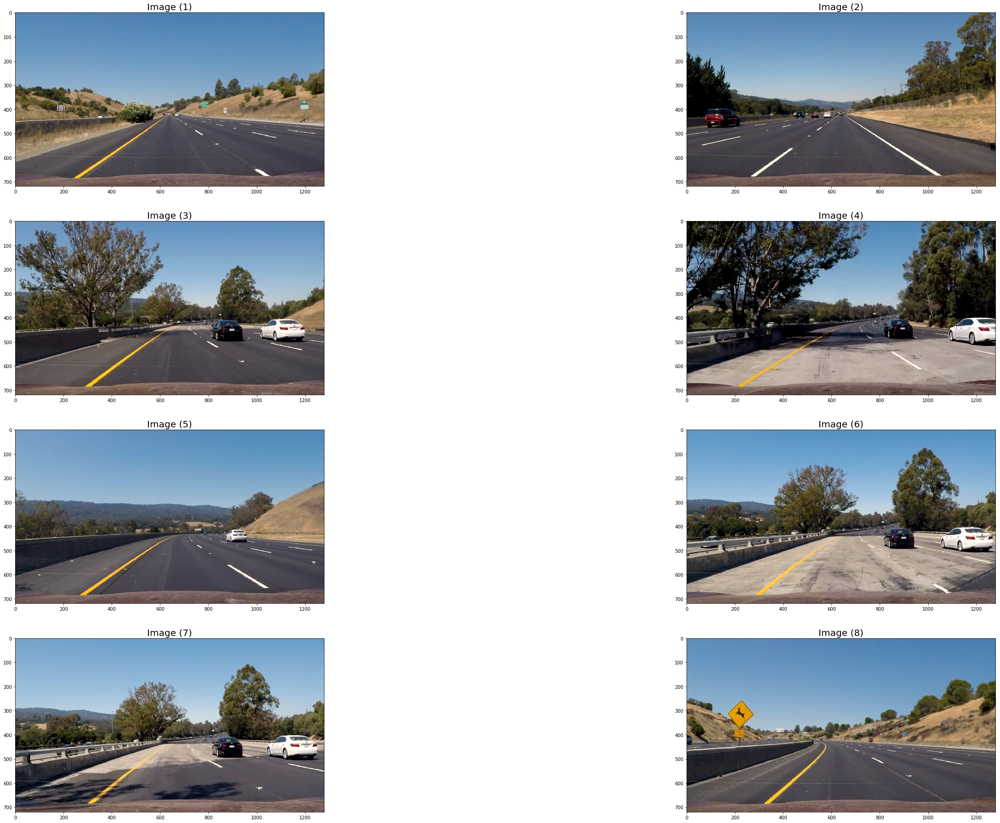

In [4]:
test_image_paths = glob.glob(os.path.join(file_root, './test_images/*.jpg'))
test_images = load_images(test_image_paths)
plot_images(test_images, 2)

## Undistorted Test Images

Plotted below are the test images after having distortion correction applied to them.

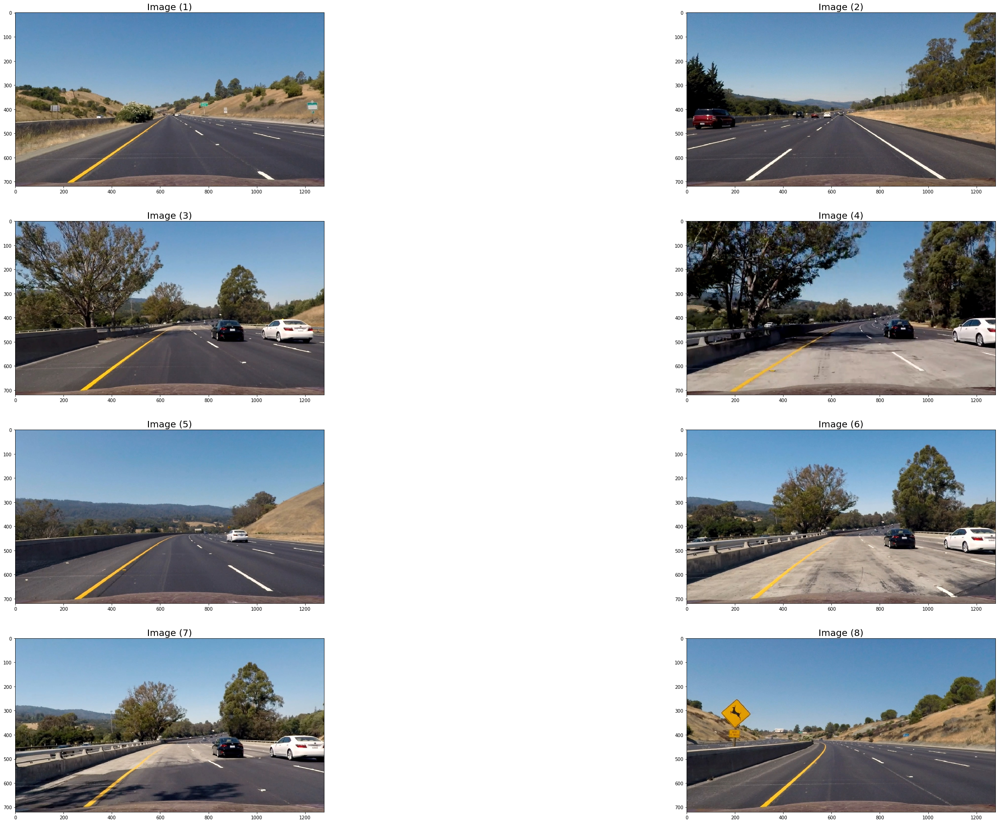

In [5]:
undistorted_images = []
for img in test_images:
    undistorted_images.append(camera.undistort_image(img))

plot_images(undistorted_images, 2)

It may be hard to see a difference in the images, but if you look near the edges you can definitely see a difference. To illustrate the difference a bit more below I have taken an undistorted image and subtracted a distorated image from it and the resulting image shows a circular warped view. Camera lens distortion warps around the edges so it would make sense that the very center of both the distorted and undistorted images are relateively the same.

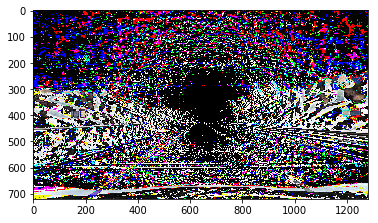

In [6]:
blank_img = np.zeros_like(test_images[0])
image_before = test_images[0]
image_after = undistorted_images[0]

blank_img = image_after - image_before

plot_image(blank_img)               

## Edge Detection

One of the most common methods of edge detection is using canny edge detection. At the core of the canny edge detection algorithm is the Sobel operator which is a kernel that iterates over the image and calculates approximate derivatives in the horizontal and vertical directions. We can fine tune the types of edges we want to detect using gradient, magnitude, and direction thresholds

### Gradient

We know that the lines we want are generally in a certain type of direction so we can apply a threshold to the sobel operation in the horizontal and vertical direction to remove edges outside of our threshold.

### Magnitude

We then apply a threshold to the size of our gradient, this allow us to filter out the smaller gradients and reduce the amount of noise in the image.

### Direction 

Lastly we apply a threshold to the orientation of the gradient. 

Plotted below are 8 images indicating steps in the process. The first 4 are the images after the gradient x, gradient y, magnitude, and direction thresholds are applied. The bottom 4 are the same images after the S channel threshold is applied.

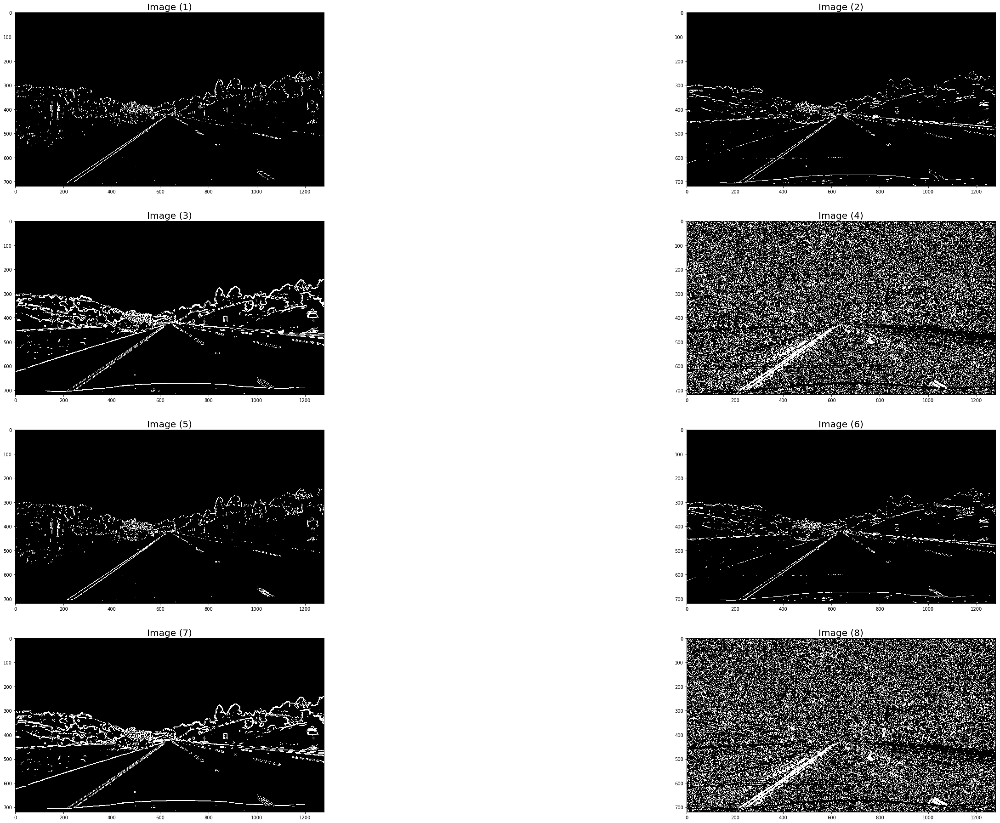

In [7]:
gradx_params = [3, (30, 100), (170, 230)] # kernel size, sobel threshold, s channel threshold
grady_params = [3, (40, 100), (170, 230)] # kernel size, sobel threshold, s channel threshold
mag_params = [11, (40, 100), (170, 230)] # kernel size, sobel threshold, s channel threshold
dir_params = [15, (0.8, 1.2), (170, 230)] # kernel size, sobel threshold, s channel threshold

combined_image = detect_edges(undistorted_images[0], gradx_params, grady_params, mag_params, dir_params, plot_steps=True)

Now with all the thresholds combined we produced the following images.

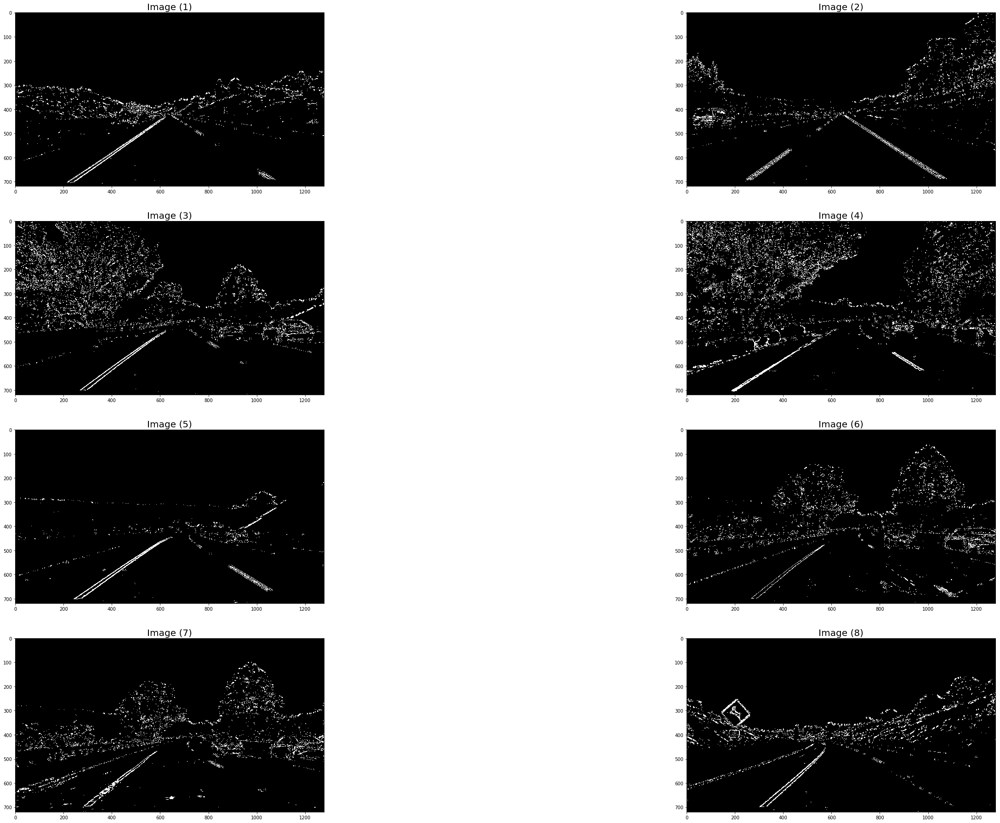

In [8]:
combined_images = []
for image in undistorted_images:
    combined_image = detect_edges(image, gradx_params, grady_params, mag_params, dir_params)
    combined_images.append(combined_image)

plot_images(combined_images, 2)

### S Channel Threshold  

We can also examine the image in different color spaces to see if there are some that allow the lane lines to appear in a variety of lighting conditions. The color spaces demonstrated below are the RGB, HLS, LAB, YCrCb, and HSV color spaces. All of the images plotted to a larger image which can be examine to find candidates for a more ideal color space. 

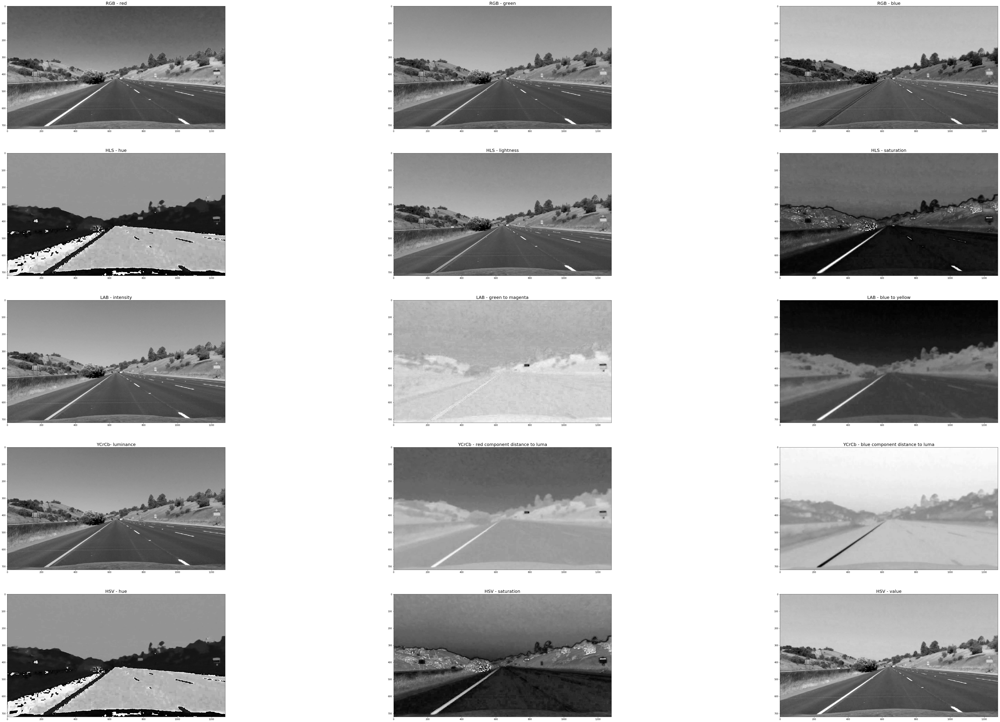

In [9]:
channels = []
labels = []

# RGB
r_channel = undistorted_images[0][:,:,0]
g_channel = undistorted_images[0][:,:,1]
b_channel = undistorted_images[0][:,:,2]

channels.append(r_channel)
channels.append(g_channel)
channels.append(b_channel)

labels.append("RGB - red")
labels.append("RGB - green")
labels.append("RGB - blue")

# HLS
hls = cv2.cvtColor(undistorted_images[0], cv2.COLOR_RGB2HLS)
h_channel = hls[:,:,0]
l_channel = hls[:,:,1]
s_channel = hls[:,:,2]

channels.append(h_channel)
channels.append(l_channel)
channels.append(s_channel)

labels.append("HLS - hue")
labels.append("HLS - lightness")
labels.append("HLS - saturation")

# LAB
Lab = cv2.cvtColor(undistorted_images[0], cv2.COLOR_RGB2LAB)
L_channel = Lab[:,:,0]
a_channel = Lab[:,:,1]
b_channel = Lab[:,:,2]

channels.append(L_channel)
channels.append(a_channel)
channels.append(b_channel)

labels.append("LAB - intensity")
labels.append("LAB - green to magenta")
labels.append("LAB - blue to yellow")

# YCrCb
ycrcb = cv2.cvtColor(undistorted_images[0], cv2.COLOR_RGB2YCrCb)
luma_channel = ycrcb[:,:,0]
red_distance_channel = ycrcb[:,:,1]
blue_distance_channel = ycrcb[:,:,2]

channels.append(luma_channel)
channels.append(red_distance_channel)
channels.append(blue_distance_channel)

labels.append("YCrCb- luminance")
labels.append("YCrCb - red component distance to luma")
labels.append("YCrCb - blue component distance to luma")

# HSV
hsv = cv2.cvtColor(undistorted_images[0], cv2.COLOR_RGB2HSV)
h_channel = hsv[:,:,0]
s_channel = hsv[:,:,1]
v_channel = hsv[:,:,2]

channels.append(h_channel)
channels.append(s_channel)
channels.append(v_channel)

labels.append("HSV - hue")
labels.append("HSV - saturation")
labels.append("HSV - value")
plot_images(channels, 3, labels=labels)

The saturation value from HLS color space seems to be the best candidate for a color space that reduces noises and keeps the lines. The left lane line is brighter in some other color spaces but the right lane line is then gone completely in those same color spaces.

### Perspective Transform

When viewing the area in front of a vehicle we can see that parallel lines converge towards a point due to perspective. This can give misleading impressions about the curvature of the lane line for example. A solution is to take a bird's eye view of the area in front of the vehicle where the actual curvature can be more properly viewed. To accomplish this with a forward facing camera we can use a perspective transform. In this project we take our source image and specify a region that we want to transform. Then we use the `getPerspectiveTransform` and `warpPerspective` methods to warp the image based on where the source points are mapped to. When using parallel lines the end result should be a top down view with the lines actually parallel and not converging to a point. `getPerspectiveTransform` returns a matrix and an inverse matrix can be created by swapping the source and destination parameters to `getPerspectiveTransform`. This allows us to draw on the image in the bird's eye view and have it transform to the appropriate locations in the normal view. Plotted below is the transform applied to the test images.

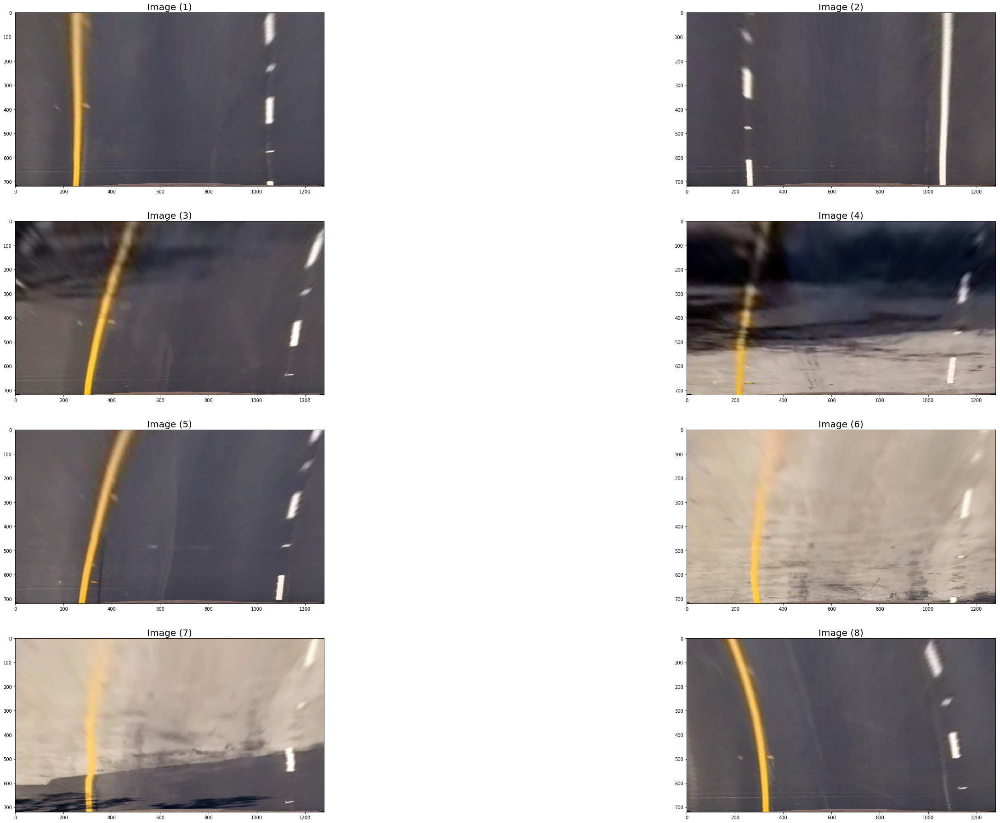

In [10]:
transformed_color_images = []
image_matrices = []

for image in undistorted_images:
    warped_img, M, M_inv = transform_perspective(image, camera)
    transformed_color_images.append(warped_img)
    image_matrices.append((M, M_inv))
    
plot_images(transformed_color_images, 2)

Plotted below is the same transform applied to the edge detected and thresholded images.

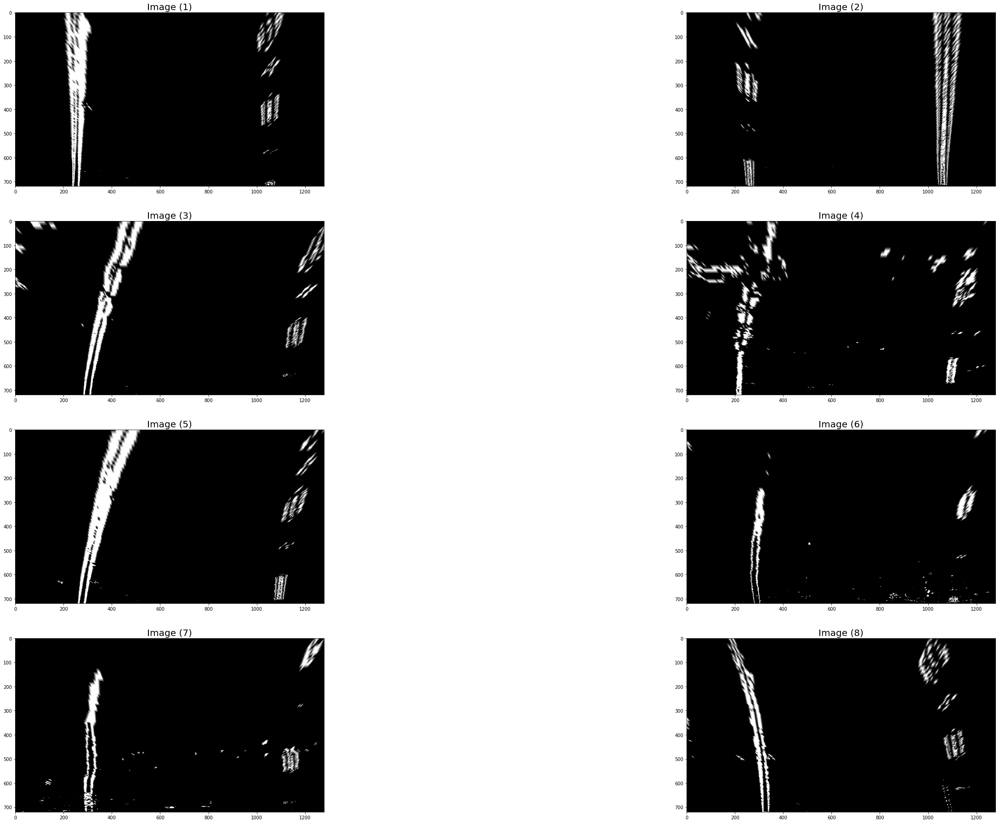

In [11]:
transformed_thresh_images = []

for image in combined_images:
    warped_img, _, _ = transform_perspective(image, camera)
    transformed_thresh_images.append(warped_img)
    
plot_images(transformed_thresh_images, 2)

### Find Lane Lines

In order to find lane lines we first take our warped and edge detected image and computer a histogram based on the average values of the bottom half of the image. Plotted below is an example

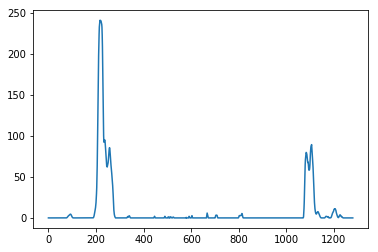

In [13]:
histogram = np.sum(transformed_thresh_images[3][transformed_thresh_images[4].shape[0] // 2:,:], axis=0)
plt.plot(histogram)

We can see from the two peaks roughly around 350 and 1100 are where the lines most likely are and serve as a good starting point for our search. The algorithm we are using for searching is called the sliding windows. We start at the left and right starting points defined by the left and right peaks in the histogram. From there we search in a predefined window size and count the number of white pixels we find in the window. If the number of pixels is more than our minpix parameter then we take the average of the pixel locations and recenter the next window as we move up. We repeat this process iteratively until we reach some terminating condition which in this case is reaching an image boundary. After detecting the points in our line we take our left and right line data and fit 2nd order polynomials to them which gives use coeffecients for an equation describing our lane line. Plotted below is the windows drawn over the color warped image.

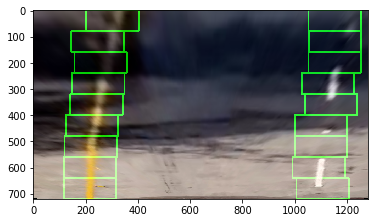

In [14]:
lane = find_lane_lines(None, transformed_thresh_images[3], 9, 100, 25)
plot_image(cv2.addWeighted(lane.out_img.astype('uint8'), 0.8, transformed_color_images[3], 1., 0.))

After we have fit the data we know that the next image is going to be somewhat similar to the previous image so we can search around the polynomial that fits our data for any subsequent iterations of the search algorithm. Next we calculate the curvature and the offset based on the lane data which are displayed in a UI.

In [15]:
left_curvature, right_curvature, offset = lane.measure_curvature_and_offset()
print(left_curvature)
print(right_curvature)
print(offset)

493.799966231
7447.1798234
0.0856422827009


We can now create a shape that represents the lane based on the lane data we extracted.

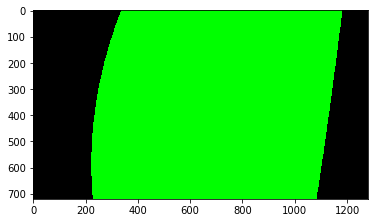

In [16]:
color_warp = lane.fill_lane()
plot_image(color_warp)

### Unwarp Image

We then use the inverse matrix created earlier to warp the shape back to our original perspective.

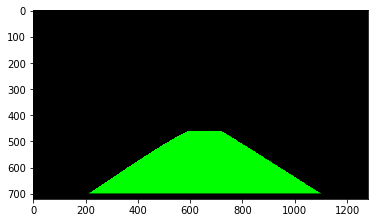

In [17]:
unwarped_img = cv2.warpPerspective(color_warp, image_matrices[3][1], (color_warp.shape[1], color_warp.shape[0]))
plot_image(unwarped_img)

### Draw UI

Lastly, we draw the shape onto the undistorted image it came from along with a UI containing the curvature values and offset.

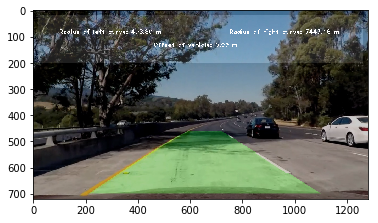

In [19]:
def draw(undist_img, unwarped_img, left_curvature, right_curvature, offset):
    result = cv2.addWeighted(undist_img, 1, unwarped_img, 0.3, 0)
    
    result_like = np.zeros_like(unwarped_img)
    cv2.rectangle(result_like, (20, 20), (result_like.shape[1] - 20, 200), [30, 30, 30], -1)

    left_curve_text = "Radius of left curve: %.2f m" % left_curvature
    cv2.putText(result_like, left_curve_text, (100, 90), cv2.FONT_HERSHEY_PLAIN, 1.5, (255,255,255), thickness=2)

    right_curve_text = "Radius of right curve: %.2f m" % right_curvature
    cv2.putText(result_like, right_curve_text, (750, 90), cv2.FONT_HERSHEY_PLAIN, 1.5, (255,255,255), thickness=2)

    offset_text = "Offset of vehicle: %.2f m" % offset
    cv2.putText(result_like, offset_text, (int(result_like.shape[1] / 2 - 180), 140), cv2.FONT_HERSHEY_PLAIN, 1.5, (255,255,255), thickness=2)
    return cv2.addWeighted(result, 0.8, result_like, 1., 0.)

drawn_image = draw(undistorted_images[3], unwarped_img, left_curvature, right_curvature, offset)
plot_image(drawn_image)

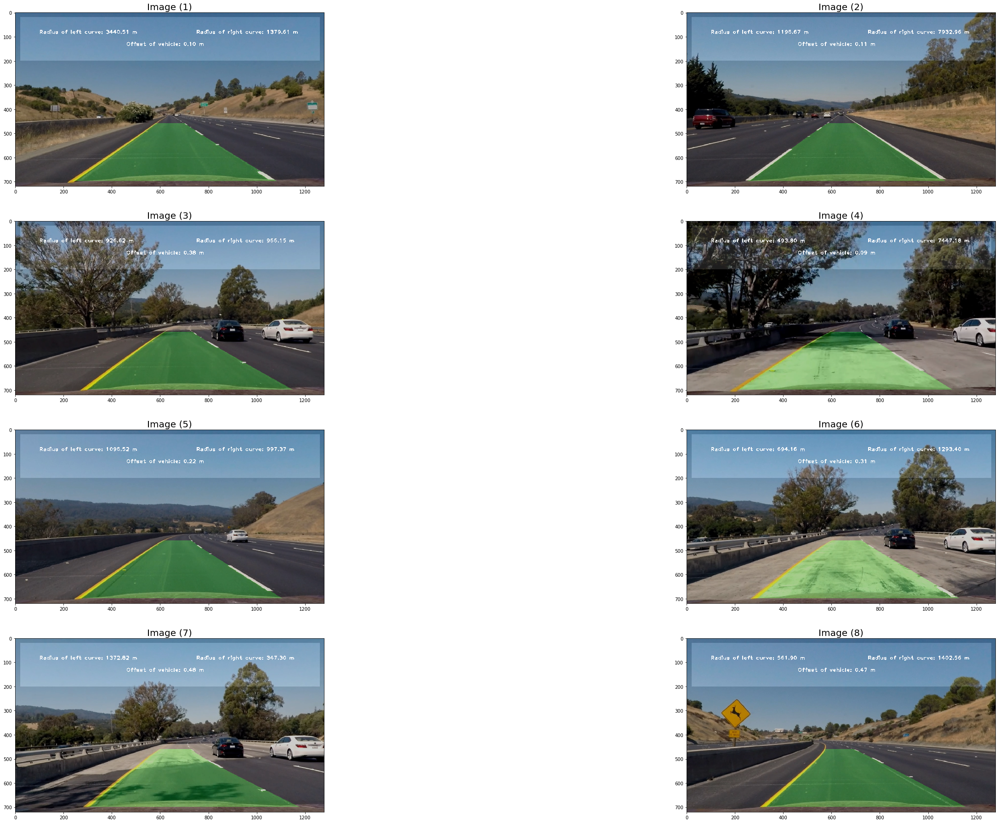

In [20]:
drawn_images = []
for i, img in enumerate(transformed_thresh_images):
    lane = find_lane_lines(None, img, 9, 100, 25)
    left_curvature, right_curvature, offset = lane.measure_curvature_and_offset()
    color_warp = lane.fill_lane()
    unwarped_img = cv2.warpPerspective(color_warp, image_matrices[i][1], (img.shape[1], img.shape[0]))
    drawn_images.append(draw(undistorted_images[i], unwarped_img, left_curvature, right_curvature, offset))

plot_images(drawn_images, 2)

### Putting Everything Together


In [21]:
def pipeline_process(camera):
    lane = None
    gradx_params = [3, (30, 100), (170, 230)] # kernel size, sobel threshold, s channel threshold
    grady_params = [3, (40, 100), (170, 230)] # kernel size, sobel threshold, s channel threshold
    mag_params = [11, (40, 100), (170, 230)] # kernel size, sobel threshold, s channel threshold
    dir_params = [15, (0.8, 1.2), (170, 230)] # kernel size, sobel threshold, s channel threshold
    nwindows = 9
    margin = 100
    minpix = 25

    def process(img):
        nonlocal lane
        undist_img = camera.undistort_image(img)
        threshold_img = detect_edges(undist_img, gradx_params, grady_params, mag_params, dir_params)
        warped_img, _, M_inv = transform_perspective(threshold_img, camera)
        lane = find_lane_lines(lane, warped_img, nwindows, margin, minpix)
        left_curvature, right_curvature, offset = lane.measure_curvature_and_offset()
        color_warp = lane.fill_lane()
        unwarped_img = cv2.warpPerspective(color_warp, M_inv, (img.shape[1], img.shape[0]))
        return draw(undist_img, unwarped_img, left_curvature, right_curvature, offset) 
    return process


### Videos

The main difference between the processing of the test images and my approach to videos is that I process the videos in a closure where a reference to the Lane object is kept in between function calls. This way I can keep track of the last n number of fits to data and average them out before filling the lane with color and calculating curvature values which smooths out the drawing.

#### Project Video

In [22]:
process = pipeline_process(camera)
project_video_output = os.path.join(file_root, './test_videos_output/project_video.mp4')
project_video_clip = VideoFileClip(os.path.join(file_root, './project_video.mp4'))
processed_clip = project_video_clip.fl_image(process)
%time processed_clip.write_videofile(project_video_output, audio=False)

t:   0%|          | 0/1260 [00:00<?, ?it/s, now=None]

Moviepy - Building video /home/n0tus/repos/sdcnd-2-advanced-lane-detection/./test_videos_output/project_video.mp4.
Moviepy - Writing video /home/n0tus/repos/sdcnd-2-advanced-lane-detection/./test_videos_output/project_video.mp4



Moviepy - Done !
Moviepy - video ready /home/n0tus/repos/sdcnd-2-advanced-lane-detection/./test_videos_output/project_video.mp4
CPU times: user 7min 44s, sys: 3.36 s, total: 7min 47s
Wall time: 4min 51s


In [30]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format('../test_videos_output/project_video.mp4'))

#### Challenge Video

In [32]:
process = pipeline_process(camera)
challenge_video_output = os.path.join(file_root, './test_videos_output/challenge_video.mp4')
challenge_video_clip = VideoFileClip(os.path.join(file_root, './challenge_video.mp4'))
processed_clip = challenge_video_clip.fl_image(process)
%time processed_clip.write_videofile(challenge_video_output, audio=False)

t:   0%|          | 0/485 [00:00<?, ?it/s, now=None]

Moviepy - Building video /home/n0tus/repos/sdcnd-2-advanced-lane-detection/./test_videos_output/challenge_video.mp4.
Moviepy - Writing video /home/n0tus/repos/sdcnd-2-advanced-lane-detection/./test_videos_output/challenge_video.mp4



Moviepy - Done !
Moviepy - video ready /home/n0tus/repos/sdcnd-2-advanced-lane-detection/./test_videos_output/challenge_video.mp4
CPU times: user 3min 6s, sys: 1.74 s, total: 3min 7s
Wall time: 1min 53s


In [33]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format('../test_videos_output/challenge_video.mp4'))

#### Harder Challenge Video

In [34]:
process = pipeline_process(camera)
harder_video_output = os.path.join(file_root, './test_videos_output/harder_challenge_video.mp4')
harder_video_clip = VideoFileClip(os.path.join(file_root, './harder_challenge_video.mp4'))
processed_clip = harder_video_clip.fl_image(process)
%time processed_clip.write_videofile(harder_video_output, audio=False)

t:   0%|          | 0/1199 [00:00<?, ?it/s, now=None]

Moviepy - Building video /home/n0tus/repos/sdcnd-2-advanced-lane-detection/./test_videos_output/harder_challenge_video.mp4.
Moviepy - Writing video /home/n0tus/repos/sdcnd-2-advanced-lane-detection/./test_videos_output/harder_challenge_video.mp4



Moviepy - Done !
Moviepy - video ready /home/n0tus/repos/sdcnd-2-advanced-lane-detection/./test_videos_output/harder_challenge_video.mp4
CPU times: user 7min 28s, sys: 3.13 s, total: 7min 32s
Wall time: 4min 43s


In [35]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format('../test_videos_output/harder_challenge_video.mp4'))

### Analysis of Approaches

The project video has fairly good results with some parts moving around a bit near the end when the car is going over concrete. The challenge videos do not lane detect very well though. The first challenge video is failing because there is high contrast from repaved asphalt in the center of the lane which is being detected as the left hand lane line. It begins to shrink until the lane line just disappears entirely. I think this could be detected earlier if we see the lane size is starting to shrink. The additional challenge along with the harder challenge video also has some strong curves which don't detect well and the lane lines seem to get crossed.